# RUN ONLY ONCE PER DATASET SPLIT, IT ALTERS THE IMAGE IN PLACE -> RELOAD THE SPLIT WHEN CREATING ANOTHER DATASET WITH AUGUMENTATIONS

# Files tree

```
./
|
+---------MedicalDecathlon
|                   |
|                   +--- archives with the cts in nii.gz format
|
|
|
|
|
|
+---------MedicalDecathlonTensors
|                   |
|                   +-----training
|                   |         |
|                   |         |
|                   |         +--- files with the cts as tensors
|                   |
|                   |
|                   |
|                   +-----validation
|                             |
|                             |
|                             +---  files with the cts as tensors
|
|
|
|
+---------MedicalDecathlonJustLungs
|                   |
|                   +-----training
|                   |         |
|                   |         |
|                   |         +--- files with the cts as tensors
|                   |
|                   |
|                   |
|                   +-----validation
|                             |
|                             |
|                             +---  files with the cts as tensors
|
|
|
+---------MedicalDecathlonJustTumours
                    |
                    +-----training
                    |         |
                    |         |
                    |         +--- files with the cts as tensors
                    |
                    |
                    |
                    +-----validation
                              |
                              |
                              +---  files with the cts as tensors


```


### IMPORTS

In [1]:
import os
import warnings
warnings.filterwarnings("ignore") # remove some scikit-image warnings


from monai.apps import DecathlonDataset
from monai.data import DataLoader
from monai.transforms import (
    LoadImageD,
    EnsureChannelFirstD,
    Compose,
    OrientationD,
    OrientationD,
)

import torch
import numpy as np
import random
import sys
from tqdm import tqdm
import pickle as pkl
import matplotlib.pyplot as plt

In [3]:
import cv2

### HYPERPARAMS ###


In [4]:
crt_dir = os.getcwd()
datasets_path = f'{crt_dir}/MedicalDecathlon/'

DOWNLOAD_FLAG = not os.path.exists(datasets_path)


KEYS = ["image", "label"]

### PREPROCESSING TRANSFORMS

In [7]:
base_transform = Compose([
    LoadImageD(keys=KEYS),
    EnsureChannelFirstD(keys=KEYS),
    OrientationD(keys=KEYS, axcodes='RAS'),
])

In [9]:
### TRAINING DATA ###
train_name = 'training' # From Monai: ['training', 'validation', 'test']
train_dataset = DecathlonDataset(root_dir = datasets_path,
                        task = "Task06_Lung", section = train_name,
                        transform = base_transform, download = DOWNLOAD_FLAG)

Loading dataset:   0%|          | 0/51 [00:00<?, ?it/s]

Loading dataset: 100%|██████████| 51/51 [03:53<00:00,  4.58s/it]


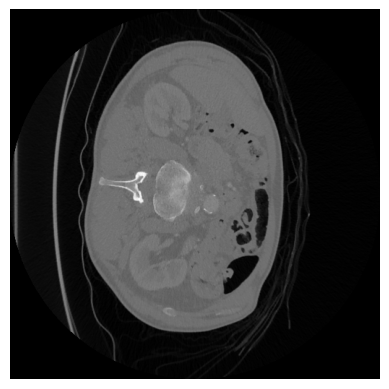

In [8]:
plt.imshow(train_dataset[0]['image'][0, ..., 10], cmap='gray')
# plt.gca().invert_yaxis()
plt.axis('off')
plt.show()

### MAIN ###

In [9]:
# We make sure to eliminate uncertainty in the data loading, by setting all the random seeds

# Set random seeds
torch.manual_seed(0)
np.random.seed(0)
random.seed(0)

In [10]:
# Memoize stacks in between, where we find the lungs
# Based on the radiologist, some CTs start from kidney area up to the cervical backbone
patient_useful_slices = {
    0 : {'start': 60, 'stop': 557},
    1 : {'start': 20 , 'stop': 243},
    2 : {'start': 0, 'stop': 213},
    3 : {'start': 48, 'stop': 437},
    4 : {'start': 52, 'stop': 258},
    5 : {'start': 59, 'stop': 244},
    6 : {'start': 9, 'stop': 122},
    7 : {'start': 44, 'stop': 260},
    8 : {'start': 3, 'stop': 237},
    9 : {'start': 330 , 'stop': 623},
    10 : {'start': 56, 'stop': 280},
    11 : {'start': 26, 'stop': 292},
    12 : {'start': 0, 'stop': 108},
    13 : {'start': 10, 'stop': 227},
    14 : {'start': 25, 'stop': 231},
    15 : {'start': 35, 'stop': 280},
    16 : {'start': 37, 'stop': 262},
    17 : {'start': 29, 'stop': 266},
    18 : {'start': 48, 'stop': 261},
    19 : {'start': 65, 'stop': 275},
    20 : {'start': 145, 'stop': 520},
    21 : {'start': 0, 'stop': 397},
    22 : {'start': 9, 'stop': 225},
    23 : {'start': 6, 'stop': 227},
    24 : {'start': 15, 'stop': 239},
    25 : {'start': 40, 'stop': 149},
    26 : {'start': 30, 'stop': 231},
    27 : {'start': 49, 'stop': 295},
    28 : {'start': 33, 'stop': 217},
    29 : {'start': 50, 'stop': 311},
    30 : {'start': 0, 'stop': 213},
    31 : {'start': 22, 'stop': 248},
    32 : {'start': 88, 'stop': 493},
    33 : {'start': 116, 'stop': 439},
    34 : {'start': 40, 'stop': 300},
    35 : {'start': 0, 'stop': 227},
    36 : {'start': 0, 'stop': 198},
    37 : {'start': 0, 'stop': 120},
    38 : {'start': 0, 'stop': 203},
    39 : {'start': 44, 'stop': 228},
    40 : {'start': 0, 'stop': 229},
    41 : {'start': 35, 'stop': 250},
    42 : {'start': 48, 'stop': 243},
    43 : {'start': 5, 'stop': 230},
    44 : {'start': 88, 'stop': 314},
    45 : {'start': 7, 'stop': 220},
    46 : {'start': 11, 'stop': 232},
    47 : {'start': 21, 'stop': 229},
    48 : {'start': 4, 'stop': 255},
    49 : {'start': 2, 'stop': 122},
    50 : {'start': 14, 'stop': 119}
}

In [1]:
patient_useful_slices_val = {
    0 : {'start': 259, 'stop': 322},
    1 : {'start': 180 , 'stop': 243},
    2 : {'start': 110, 'stop': 173},
    3 : {'start': 196, 'stop': 259},
    4 : {'start': 17, 'stop': 80},
    5 : {'start': 81, 'stop': 144},
    6 : {'start': 80, 'stop': 143},
    7 : {'start': 73, 'stop': 136},
    8 : {'start': 65, 'stop': 128},
    9 : {'start': 131 , 'stop': 194},
    10 : {'start': 300, 'stop': 363},
    11 : {'start': 58, 'stop': 121},
}

In [2]:
for val_key in patient_useful_slices_val.keys():
    print(f'Patient {val_key} has {patient_useful_slices_val[val_key]["stop"] - patient_useful_slices_val[val_key]["start"]} slices')

Patient 0 has 63 slices
Patient 1 has 63 slices
Patient 2 has 63 slices
Patient 3 has 63 slices
Patient 4 has 63 slices
Patient 5 has 63 slices
Patient 6 has 63 slices
Patient 7 has 63 slices
Patient 8 has 63 slices
Patient 9 has 63 slices
Patient 10 has 63 slices
Patient 11 has 63 slices


In [12]:
def plots_bar_hist_interface(counts_list, split_name, counts_name, verbose_flag = False):
    '''
    Interface function used for quantitative measures on slices per patient or tumorous slices per patient

    1 x 2 grid of plots:
    - Barplot: Number of quantity in CT for each patient based on patients ID
    - Histogram: Count of patients with at least determined quantity in CT
    '''

    NO_PATIENTS = len(counts_list)
    mean_counts = np.mean(counts_list)
    std_counts = np.std(counts_list)

    print(f'Mean number of {counts_name}: {mean_counts}')
    print(f'Std for the number of {counts_name}: {std_counts}')

    fig, ax = plt.subplots(1,2, figsize=(15, 5))

    # Slices
    ax[0].bar(range(NO_PATIENTS), counts_list)

    # Add the number of slices as text on top of each bar
    if verbose_flag:
        for i in range(NO_PATIENTS):
            ax[0].text(i, counts_list[i], f'{counts_list[i]}', ha='center')

    # Add the mean as a red line, starting from 0 to NO_PATIENTS
    ax[0].axhline(mean_counts, color='red', label='Mean')

    # Add variance as a yellow faded area
    ax[0].fill_between(np.arange(-0.5, NO_PATIENTS+0.5), mean_counts - std_counts, mean_counts + std_counts, color='yellow', alpha=0.5, label='Variance')

    ax[0].set_xlim(-1, NO_PATIENTS)
    ax[0].set_xlabel('Patient')
    ax[0].set_ylabel(f'Number of {counts_name} in CT')
    ax[0].set_title(f'{split_name.capitalize()}: Number of {counts_name} in CT for each patient')
    ax[0].legend()

    # Slices
    plt.hist(counts_list, bins=10)

    # Add the mean as a red line
    ax[1].set_xlabel(f'Number of {counts_name} in CT')
    ax[1].set_ylabel(f'Number of patients with {counts_name} in CT')
    ax[1].set_title(f'{train_name.capitalize()}: Number of {counts_name} in CT for each patient - Histogram')
    fig.show()
    plt.show()

    return mean_counts, std_counts


In [13]:
patients = [patient_useful_slices[i]['stop'] - patient_useful_slices[i]['start'] for i in range(len(patient_useful_slices))]

Mean number of slices: 229.8235294117647
Std for the number of slices: 75.45124536254481


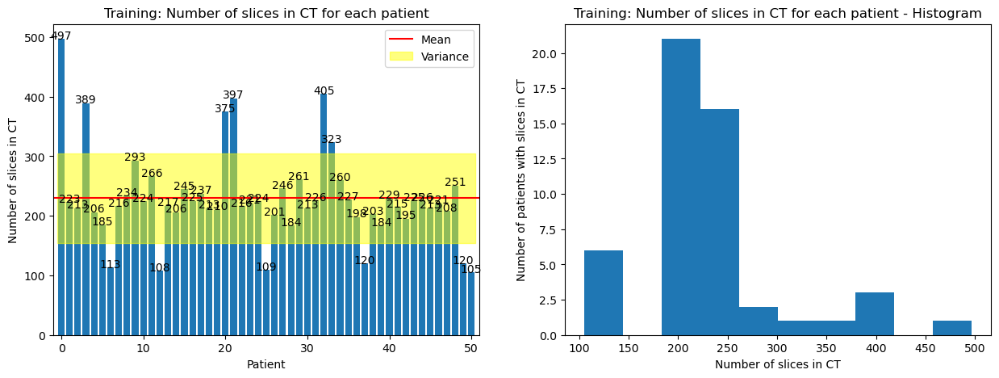

(229.8235294117647, 75.45124536254481)

In [14]:
plots_bar_hist_interface(patients, train_name, 'slices', verbose_flag = True)

In [15]:
# Memoize stacks where the tumor is present
# Computed in MSD EDA notebook
patient_tumorous_slices = {
    0: {'start': 326, 'stop': 411},
    1: {'start': 171, 'stop': 227},
    2: {'start': 147, 'stop': 193},
    3: {'start': 303, 'stop': 335},
    4: {'start': 141, 'stop': 167},
    5: {'start': 131, 'stop': 188},
    6: {'start': 71, 'stop': 95},
    7: {'start': 164, 'stop': 192},
    8: {'start': 145, 'stop': 180},
    9: {'start': 513, 'stop': 549},
    10: {'start': 197, 'stop': 272},
    11: {'start': 223, 'stop': 258},
    12: {'start': 59, 'stop': 83},
    13: {'start': 59, 'stop': 99},
    14: {'start': 178, 'stop': 207},
    15: {'start': 141, 'stop': 172},
    16: {'start': 127, 'stop': 177},
    17: {'start': 192, 'stop': 221},
    18: {'start': 209, 'stop': 239},
    19: {'start': 152, 'stop': 194},
    20: {'start': 439, 'stop': 494},
    21: {'start': 291, 'stop': 341},
    22: {'start': 136, 'stop': 180},
    23: {'start': 137, 'stop': 169},
    24: {'start': 84, 'stop': 112},
    25: {'start': 82, 'stop': 109},
    26: {'start': 79, 'stop': 126},
    27: {'start': 208, 'stop': 293},
    28: {'start': 137, 'stop': 173},
    29: {'start': 120, 'stop': 149},
    30: {'start': 130, 'stop': 173},
    31: {'start': 97, 'stop': 123},
    32: {'start': 356, 'stop': 415},
    33: {'start': 203, 'stop': 287},
    34: {'start': 200, 'stop': 228},
    35: {'start': 148, 'stop': 184},
    36: {'start': 79, 'stop': 105},
    37: {'start': 66, 'stop': 100},
    38: {'start': 117, 'stop': 143},
    39: {'start': 111, 'stop': 181},
    40: {'start': 140, 'stop': 165},
    41: {'start': 80, 'stop': 109},
    42: {'start': 79, 'stop': 172},
    43: {'start': 153, 'stop': 204},
    44: {'start': 147, 'stop': 188},
    45: {'start': 113, 'stop': 142},
    46: {'start': 83, 'stop': 113},
    47: {'start': 140, 'stop': 234},
    48: {'start': 141, 'stop': 170},
    49: {'start': 99, 'stop': 120},
    50: {'start': 68, 'stop': 92}
}

In [16]:
# Memoize the bounding boxes for 2D slices to remove the bed and other noise signals
# More details in niibabel.ipynb
bbox_2d = (60, 450, 119, 425)


In [17]:
crt_patient = train_dataset[0]['image']


from copy import deepcopy

a = deepcopy(crt_patient)

a = min_max_normalize(a)





NameError: name 'min_max_normalize' is not defined

In [ ]:
# Convert to numpy
a = a.numpy()


# Taking a matrix of size 5 as the kernel 
kernel = np.ones((5, 5), np.uint8) 
  
# The first parameter is the original image, 
# kernel is the matrix with which image is 
# convolved and third parameter is the number 
# of iterations, which will determine how much 
# you want to erode/dilate a given image. 

img = a[0,...,0]
img_erosion = cv2.erode(img, kernel, iterations=1) 
img_dilation = cv2.dilate(img_erosion, kernel, iterations=1) 
  

fig, axes = plt.subplots(1, 3, figsize=(15, 5))
axes[0].imshow(img, cmap='gray')
axes[0].set_title('Original')
axes[0].axis('off')
axes[1].imshow(img_erosion, cmap='gray')
axes[1].set_title('Erosion')
axes[1].axis('off')
axes[2].imshow(img_dilation, cmap='gray')
axes[2].set_title('Dilation')
axes[2].axis('off')

plt.show()


NameError: name 'a' is not defined

In [ ]:
a.shape

torch.Size([512, 512, 589])

In [15]:

def min_max_normalize(img):
    no_stacks = img.shape[-1]

    for i in range(no_stacks):
        img[:, :, :, i] = (img[:, :, :, i] - img[:, :, :, i].min()) / (img[:, :, :, i].max() - img[:, :, :, i].min())

    plt.imshow(img[0, ..., 5], cmap='gray')
    
    plt.gca().invert_yaxis()
    plt.axis('off')
    plt.show()


    return img

def clahe_normalize(img, clahe_filter):
    print('CLAHE normalization')
    no_stacks = img.shape[-1]

    for i in range(no_stacks):
        img[0, ..., i]  = torch.Tensor(clahe_filter.apply(img[0, ..., i].numpy().astype(np.uint8)))

    plt.imshow(img[0, ..., 5], cmap='gray')
    
    plt.gca().invert_yaxis()
    plt.axis('off')
    plt.show()

    # sys.exit()
    return img

def remove_bed(img, bbox):
    '''
    Remove the bed from the image
    '''

    min_img = img.min()
    new_img = torch.ones_like(img) * min_img

    new_img[:, bbox[0]:bbox[1], bbox[2]:bbox[3], :] = img[:, bbox[0]:bbox[1], bbox[2]:bbox[3], :] 

    return new_img

In [8]:
def create_folder_structure(path : str, split_name : str):
    '''
    Create the folder structure for the dataset:
    - PathName/training/images
    - PathName/training/labels
    - PathName/validation/images
    - PathName/validation/labels

    or if the PathName already exists, create the folder structure for the split:
    - PathName/split_name/images
    - PathName/split_name/labels

    returns PathName/split_name/
    '''
        
    if not os.path.exists(path):
        os.makedirs(path)
        os.makedirs(f'{path}/training/')
        os.makedirs(f'{path}/training/images/')
        os.makedirs(f'{path}/training/labels/')
        os.makedirs(f'{path}/validation/')
        os.makedirs(f'{path}/validation/images/')
        os.makedirs(f'{path}/validation/labels/')

    if not os.path.exists(f'{path}/{split_name}/'):
        os.makedirs(f'{path}/{split_name}/')
        os.makedirs(f'{path}/{split_name}/images/')
        os.makedirs(f'{path}/{split_name}/labels/')

    return f'{path}/{split_name}/'


def save_dataset(dataset, dataset_name, split_name, take_slices_flag : bool = False, slices : {int : {str : int}} = None, normalize_flag : bool = False, normalization_method : str = 'min-max', remove_bed_flag : bool = False, lungs_bbox : (int, int, int, int) = None):
    '''
    Save the dataset to the disk per patient as two files: image and mask
    '''


    crt_path = create_folder_structure(f'{crt_dir}/{dataset_name}', split_name)


    for i, data in enumerate(tqdm(dataset)):
        img, label = data['image'], data['label']
                
        new_img = torch.Tensor(img)
        new_label = torch.Tensor(label)
        
        # plt.imshow(img[0, ..., 5], cmap='gray')
        # plt.show()

        if take_slices_flag:
            print(slices[i]['start'], slices[i]['stop'])
            new_img = new_img[:, :, :, slices[i]['start'] : (slices[i]['stop']+1)]
            new_label = new_label[:, :, :, slices[i]['start'] : (slices[i]['stop']+1)]


        # print(f'Patient {i} has {img.shape[-1]} slices')

        # plt.imshow(new_img[0, ..., 5], cmap='gray')
        # plt.show()
        # sys.exit()


        if normalize_flag:
            if normalization_method == 'min-max':
                new_img = min_max_normalize(new_img)
            elif normalization_method == 'clahe':
                _clipLimit = 4.0
                clahe_filter = cv2.createCLAHE(clipLimit = _clipLimit)


                # plt.imshow(img[0, ..., 5], cmap='gray')
                # plt.show()


                new_img = clahe_normalize(new_img, clahe_filter)
            else:
                raise ValueError('Invalid normalization method')

        # plt.imshow(img[0, ..., 5], cmap='gray')
        # plt.show()
            
        if remove_bed_flag:
            new_img = remove_bed(new_img, lungs_bbox)

        # plt.imshow(img[0, ..., 5], cmap='gray')
        # plt.show()
        # plt.figure().clear()
        # plt.close('all')
        # sys.exit()


        print(f'Patient {i} has {img.shape[-1]} slices')

        filename = f'{crt_path}/images/patient_{i}.pt'
        maskname = f'{crt_path}/labels/patient_{i}.pt'

        torch.save(new_img, filename)
        torch.save(new_label, maskname)


    print(f'Saved {i} images and masks for {split_name} split')

In [39]:
# save_dataset(train_dataset, 'MedicalDecathlonTensors', train_name)

In [40]:
# save_dataset(train_dataset, 'MedicalDecathlonJustLungs', train_name, take_slices_flag = True, slices = patient_useful_slices)

In [41]:
# save_dataset(train_dataset, 'MedicalDecathlonJustTumors', train_name, take_slices_flag = True, slices = patient_tumorous_slices)

  0%|          | 0/51 [00:00<?, ?it/s]

326 411


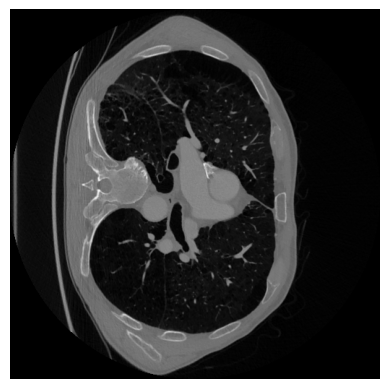

Patient 0 has 589 slices


  2%|▏         | 1/51 [00:01<00:59,  1.19s/it]

171 227


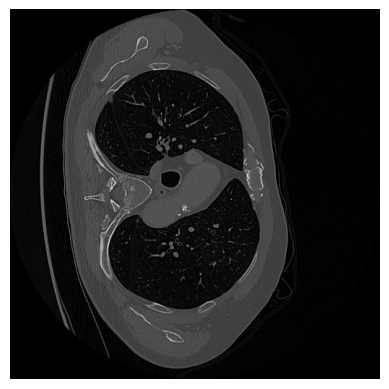

Patient 1 has 267 slices


  4%|▍         | 2/51 [00:01<00:42,  1.16it/s]

147 193


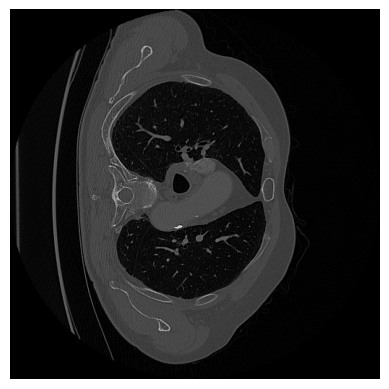

Patient 2 has 227 slices


  6%|▌         | 3/51 [00:02<00:34,  1.38it/s]

303 335


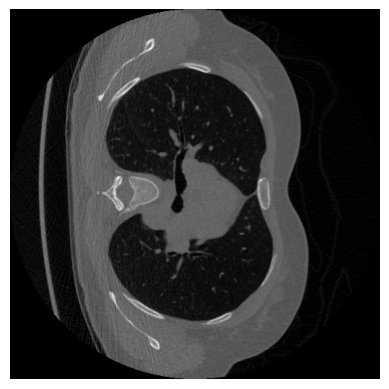

Patient 3 has 450 slices


  8%|▊         | 4/51 [00:03<00:37,  1.26it/s]

141 167


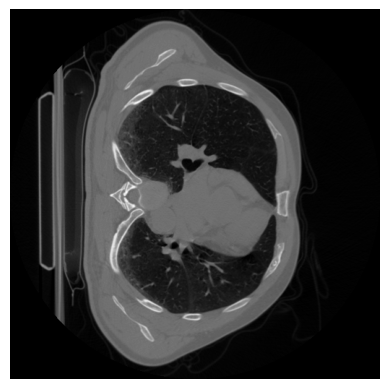

Patient 4 has 277 slices


 10%|▉         | 5/51 [00:03<00:33,  1.36it/s]

131 188


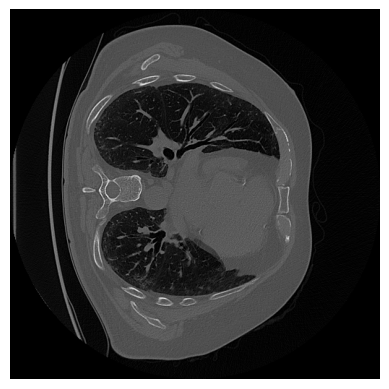

Patient 5 has 260 slices


 12%|█▏        | 6/51 [00:04<00:35,  1.25it/s]

71 95


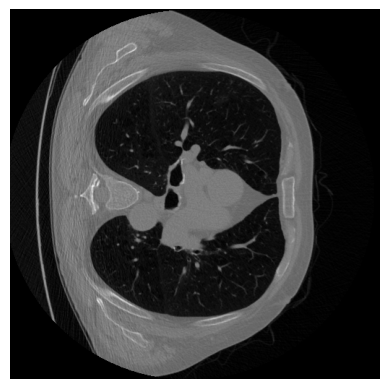

Patient 6 has 125 slices


 14%|█▎        | 7/51 [00:05<00:28,  1.53it/s]

164 192


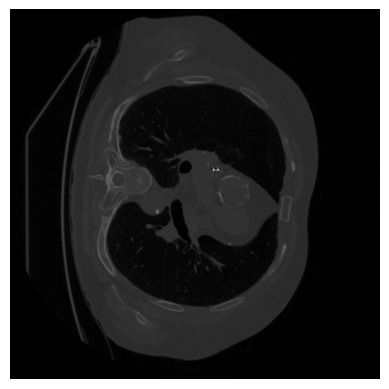

Patient 7 has 273 slices


 16%|█▌        | 8/51 [00:05<00:27,  1.58it/s]

145 180


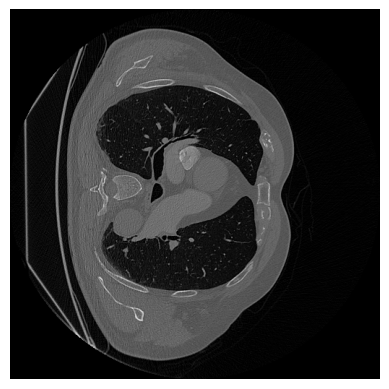

Patient 8 has 251 slices


 18%|█▊        | 9/51 [00:06<00:25,  1.64it/s]

513 549


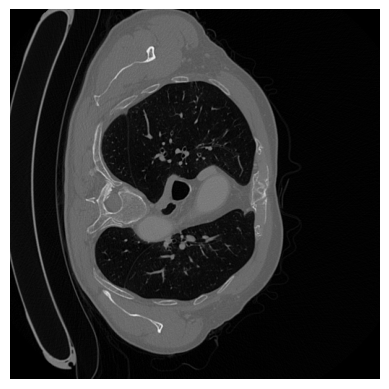

Patient 9 has 636 slices


 20%|█▉        | 10/51 [00:07<00:31,  1.32it/s]

197 272


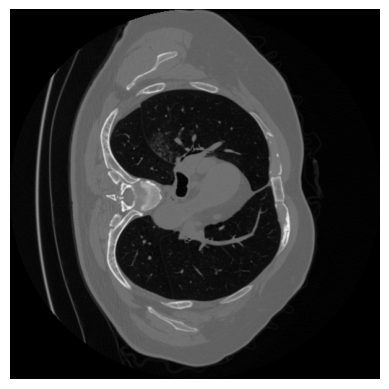

Patient 10 has 301 slices


 22%|██▏       | 11/51 [00:08<00:30,  1.30it/s]

223 258


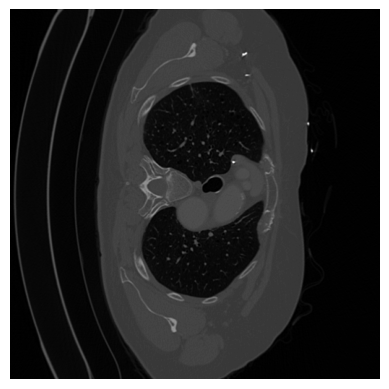

Patient 11 has 304 slices


 24%|██▎       | 12/51 [00:08<00:28,  1.36it/s]

59 83


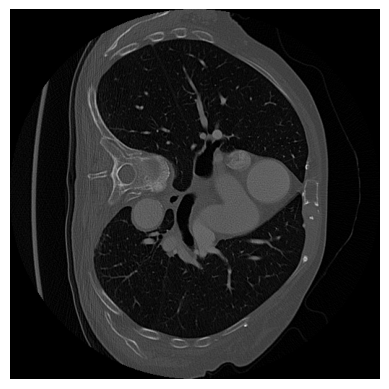

Patient 12 has 115 slices


 25%|██▌       | 13/51 [00:09<00:23,  1.62it/s]

59 99


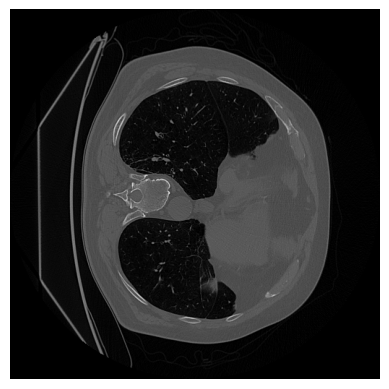

Patient 13 has 241 slices


 27%|██▋       | 14/51 [00:09<00:22,  1.65it/s]

178 207


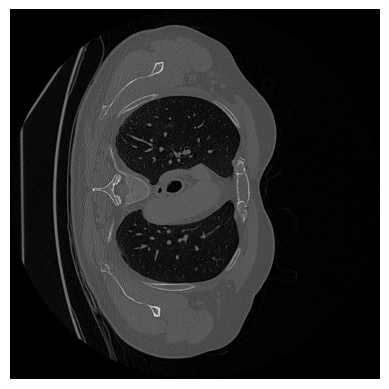

Patient 14 has 249 slices


 29%|██▉       | 15/51 [00:10<00:21,  1.66it/s]

141 172


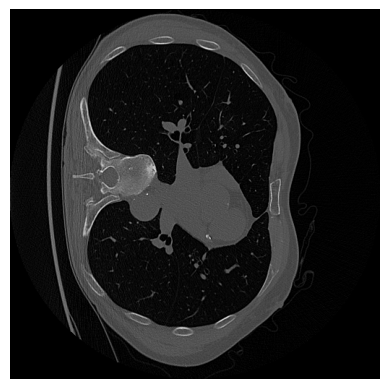

Patient 15 has 289 slices


 31%|███▏      | 16/51 [00:10<00:20,  1.69it/s]

127 177


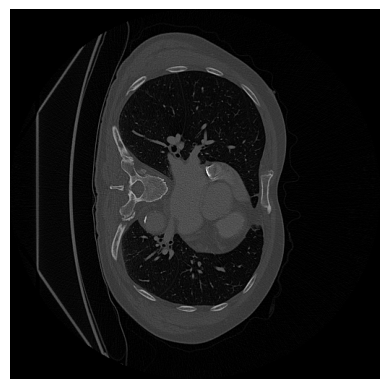

Patient 16 has 282 slices


 33%|███▎      | 17/51 [00:11<00:21,  1.58it/s]

192 221


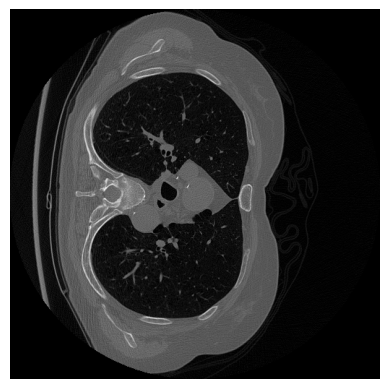

Patient 17 has 291 slices


 35%|███▌      | 18/51 [00:12<00:20,  1.60it/s]

209 239


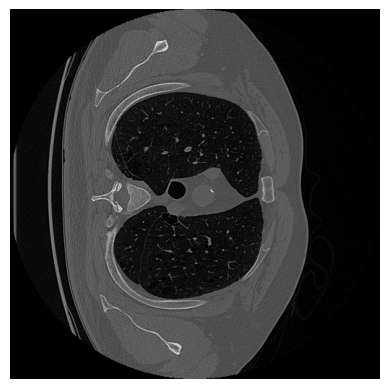

Patient 18 has 276 slices


 37%|███▋      | 19/51 [00:12<00:19,  1.63it/s]

152 194


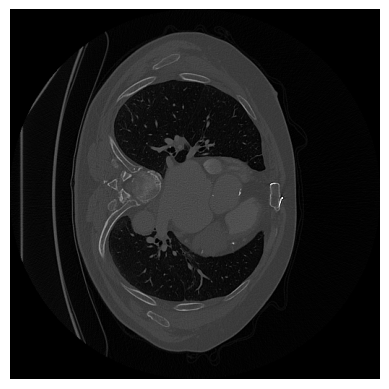

Patient 19 has 296 slices


 39%|███▉      | 20/51 [00:13<00:19,  1.63it/s]

439 494


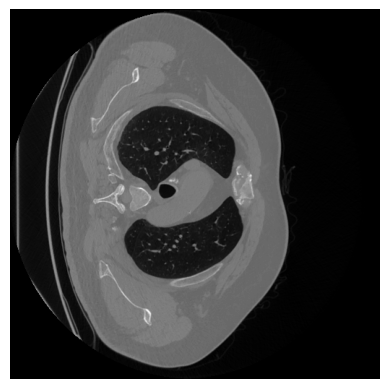

Patient 20 has 567 slices


 41%|████      | 21/51 [00:14<00:21,  1.37it/s]

291 341


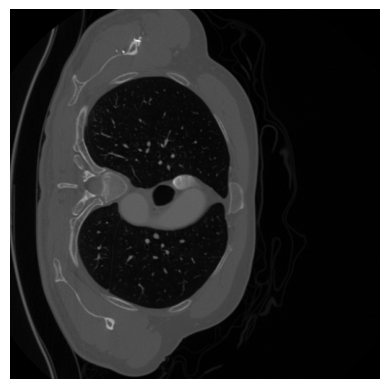

Patient 21 has 423 slices


 43%|████▎     | 22/51 [00:15<00:22,  1.29it/s]

136 180


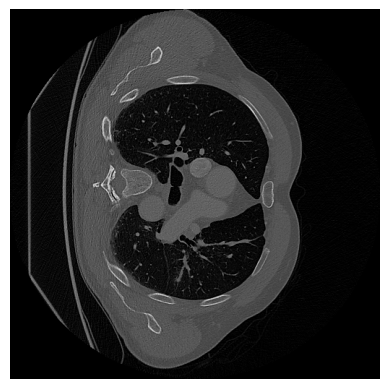

Patient 22 has 242 slices


 45%|████▌     | 23/51 [00:16<00:20,  1.33it/s]

137 169


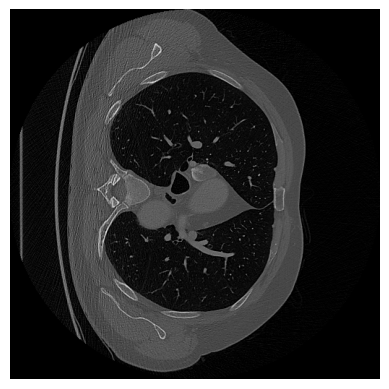

Patient 23 has 243 slices


 47%|████▋     | 24/51 [00:16<00:18,  1.45it/s]

84 112


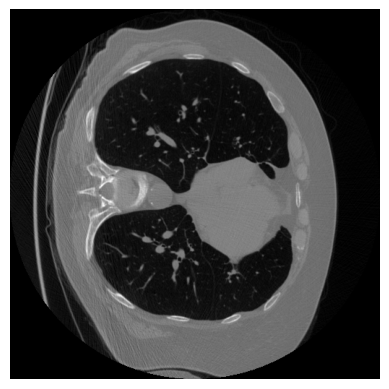

Patient 24 has 251 slices


 49%|████▉     | 25/51 [00:17<00:16,  1.53it/s]

82 109


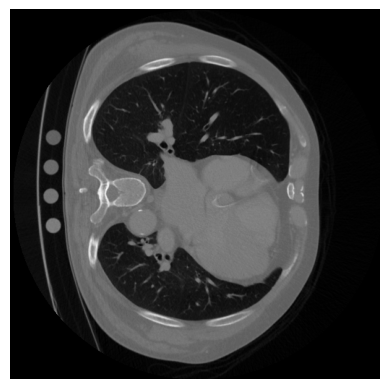

Patient 25 has 155 slices


 51%|█████     | 26/51 [00:17<00:14,  1.67it/s]

79 126


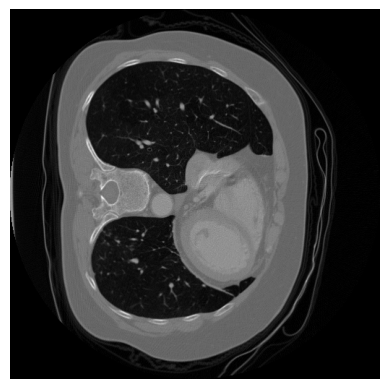

Patient 26 has 241 slices


 53%|█████▎    | 27/51 [00:18<00:14,  1.68it/s]

208 293


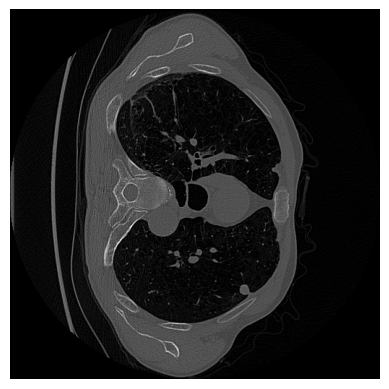

Patient 27 has 304 slices


 55%|█████▍    | 28/51 [00:19<00:15,  1.51it/s]

137 173


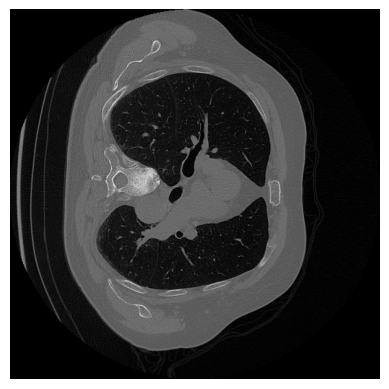

Patient 28 has 228 slices


 57%|█████▋    | 29/51 [00:19<00:13,  1.61it/s]

120 149


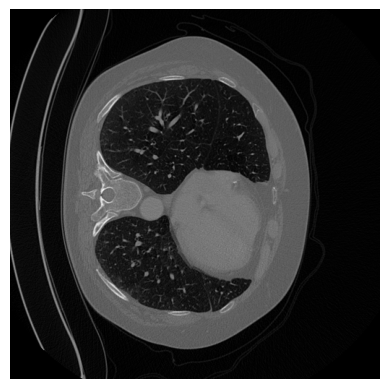

Patient 29 has 322 slices


 59%|█████▉    | 30/51 [00:20<00:13,  1.60it/s]

130 173


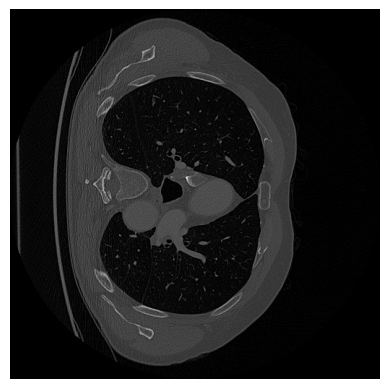

Patient 30 has 226 slices


 61%|██████    | 31/51 [00:20<00:12,  1.63it/s]

97 123


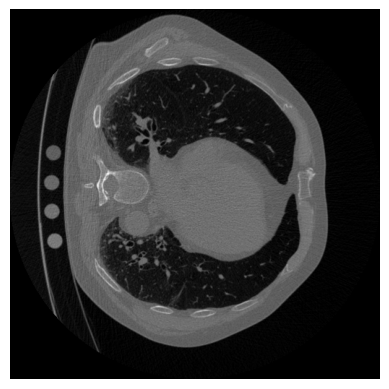

Patient 31 has 256 slices


 63%|██████▎   | 32/51 [00:21<00:11,  1.65it/s]

356 415


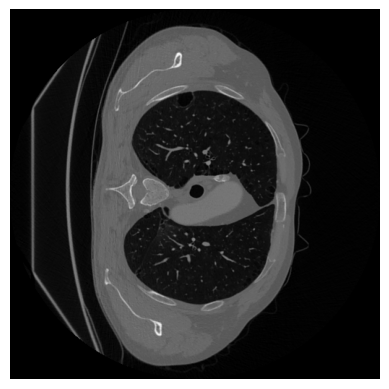

Patient 32 has 531 slices


 65%|██████▍   | 33/51 [00:22<00:12,  1.41it/s]

203 287


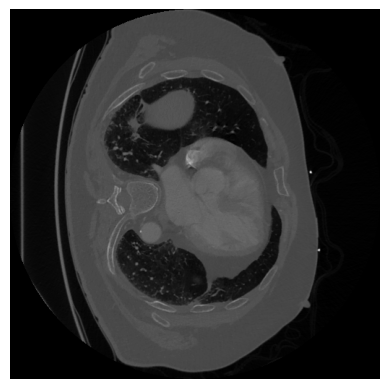

Patient 33 has 483 slices


 67%|██████▋   | 34/51 [00:23<00:13,  1.26it/s]

200 228


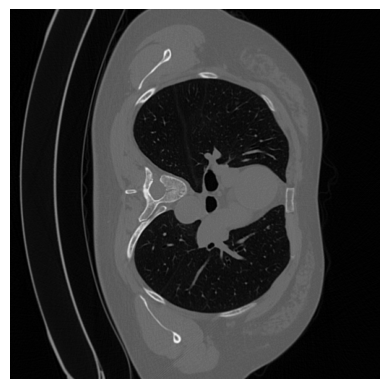

Patient 34 has 314 slices


 69%|██████▊   | 35/51 [00:23<00:12,  1.33it/s]

148 184


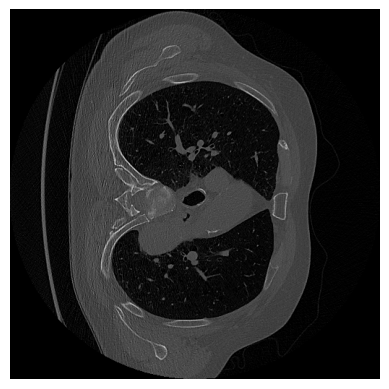

Patient 35 has 241 slices


 71%|███████   | 36/51 [00:24<00:10,  1.39it/s]

79 105


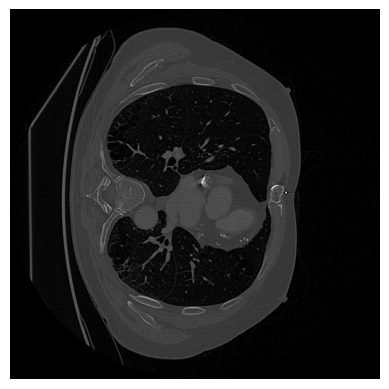

Patient 36 has 211 slices


 73%|███████▎  | 37/51 [00:25<00:09,  1.55it/s]

66 100


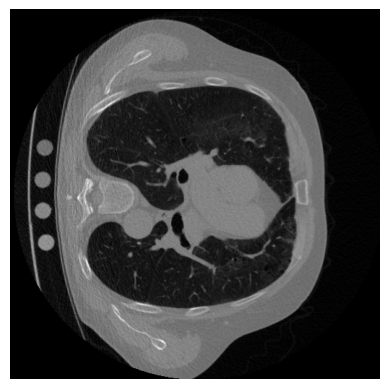

 75%|███████▍  | 38/51 [00:25<00:07,  1.68it/s]

Patient 37 has 128 slices
117 143


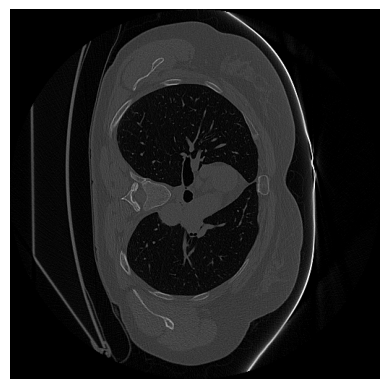

Patient 38 has 218 slices


 76%|███████▋  | 39/51 [00:26<00:07,  1.68it/s]

111 181


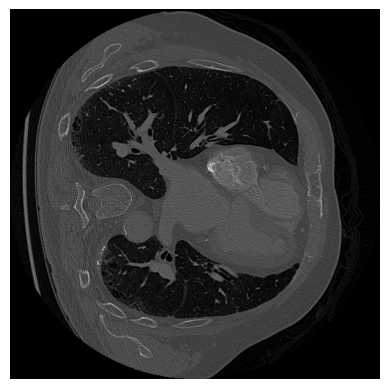

Patient 39 has 248 slices


 78%|███████▊  | 40/51 [00:26<00:06,  1.57it/s]

140 165


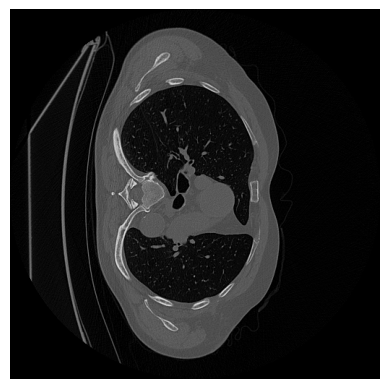

Patient 40 has 241 slices


 80%|████████  | 41/51 [00:27<00:06,  1.62it/s]

80 109


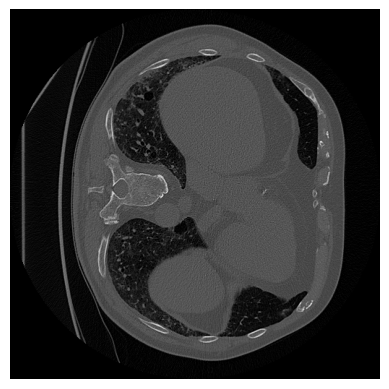

Patient 41 has 271 slices


 82%|████████▏ | 42/51 [00:28<00:05,  1.66it/s]

79 172


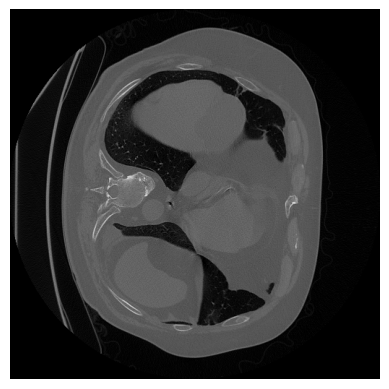

Patient 42 has 251 slices


 84%|████████▍ | 43/51 [00:28<00:05,  1.52it/s]

153 204


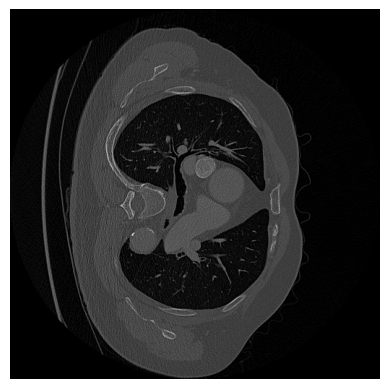

Patient 43 has 241 slices


 86%|████████▋ | 44/51 [00:29<00:04,  1.52it/s]

147 188


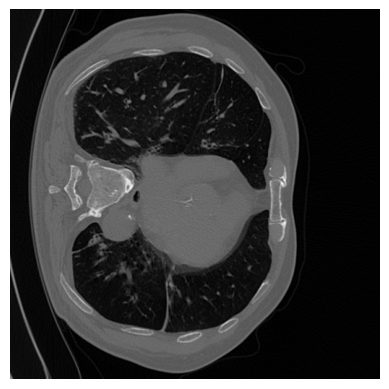

Patient 44 has 329 slices


 88%|████████▊ | 45/51 [00:30<00:04,  1.49it/s]

113 142


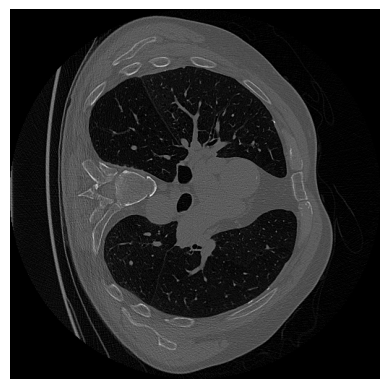

Patient 45 has 228 slices


 90%|█████████ | 46/51 [00:30<00:03,  1.60it/s]

83 113


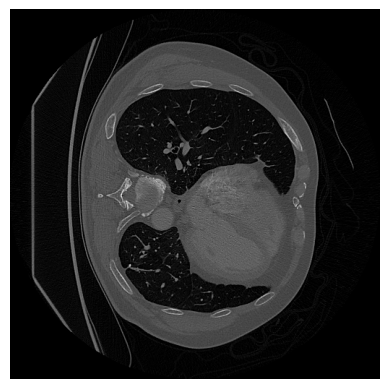

Patient 46 has 242 slices


 92%|█████████▏| 47/51 [00:31<00:02,  1.61it/s]

140 234


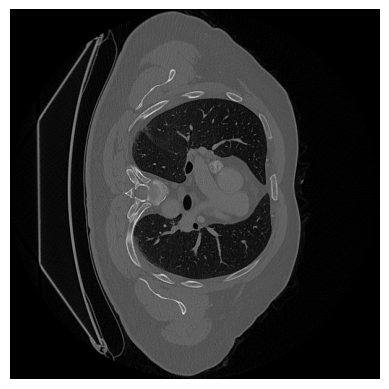

 94%|█████████▍| 48/51 [00:32<00:02,  1.46it/s]

Patient 47 has 252 slices
141 170


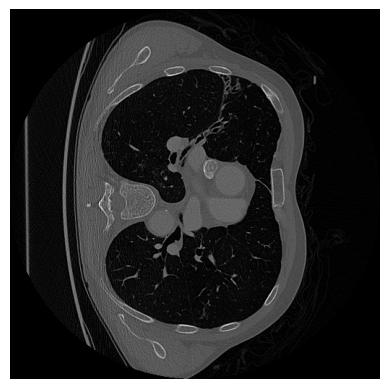

 96%|█████████▌| 49/51 [00:32<00:01,  1.55it/s]

Patient 48 has 266 slices
99 120


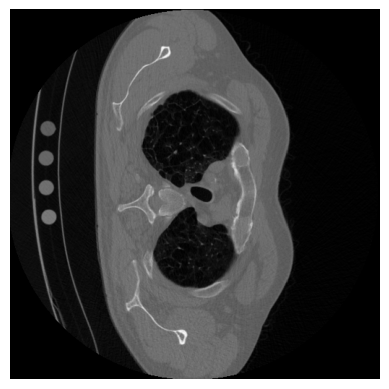

Patient 49 has 126 slices


 98%|█████████▊| 50/51 [00:33<00:00,  1.79it/s]

68 92


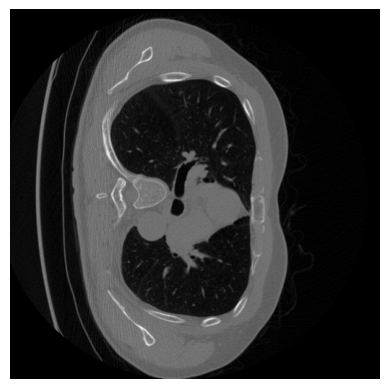

Patient 50 has 125 slices


100%|██████████| 51/51 [00:33<00:00,  1.53it/s]

Saved 50 images and masks for training split


In [22]:
# save_dataset(train_dataset, 'MedicalDecathlonAugmentedLungs', train_name, take_slices_flag = True, slices = patient_tumorous_slices, normalize_flag = True, normalization_method = 'min-max', remove_bed_flag = True, lungs_bbox = bbox_2d)

  0%|          | 0/51 [00:00<?, ?it/s]

326 411
CLAHE normalization


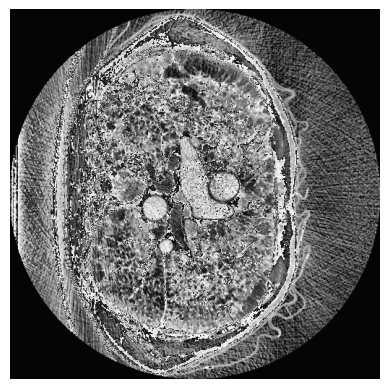

Patient 0 has 589 slices


  2%|▏         | 1/51 [00:01<01:10,  1.42s/it]

171 227
CLAHE normalization


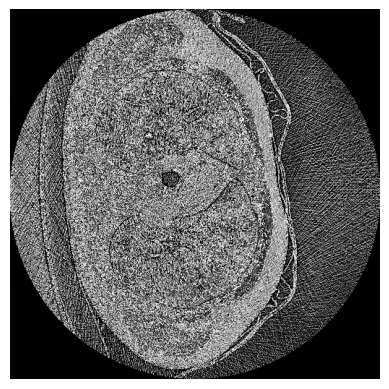

  4%|▍         | 2/51 [00:02<00:51,  1.05s/it]

Patient 1 has 267 slices
147 193
CLAHE normalization


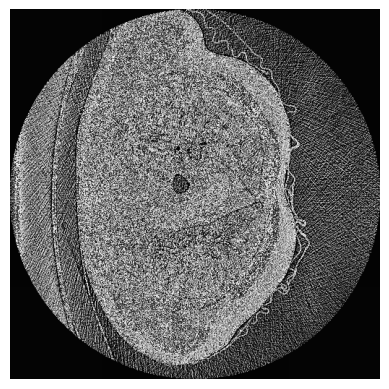

  6%|▌         | 3/51 [00:02<00:43,  1.11it/s]

Patient 2 has 227 slices
303 335
CLAHE normalization


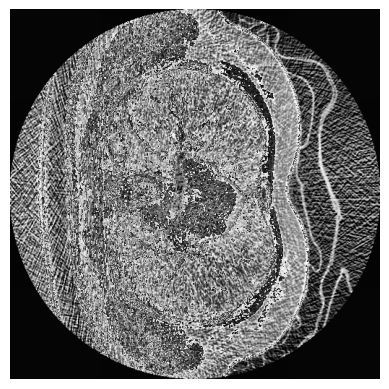

Patient 3 has 450 slices


  8%|▊         | 4/51 [00:03<00:41,  1.13it/s]

141 167
CLAHE normalization


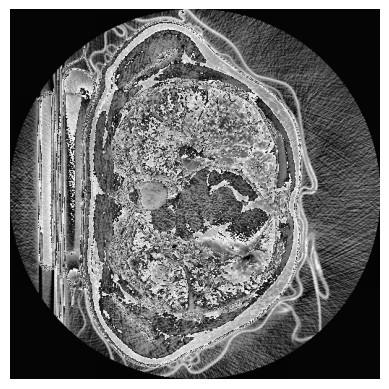

Patient 4 has 277 slices


 10%|▉         | 5/51 [00:04<00:36,  1.27it/s]

131 188
CLAHE normalization


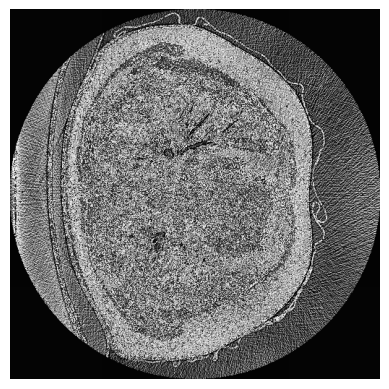

Patient 5 has 260 slices


 12%|█▏        | 6/51 [00:05<00:35,  1.26it/s]

71 95
CLAHE normalization


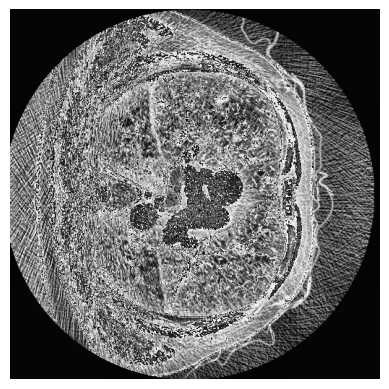

 14%|█▎        | 7/51 [00:05<00:29,  1.47it/s]

Patient 6 has 125 slices
164 192
CLAHE normalization


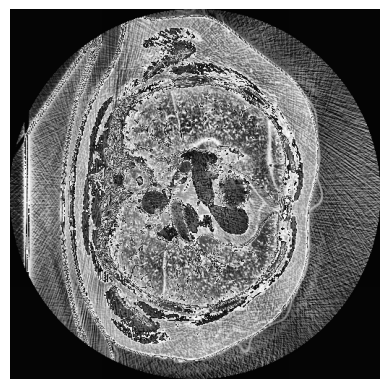

Patient 7 has 273 slices


 16%|█▌        | 8/51 [00:06<00:28,  1.51it/s]

145 180
CLAHE normalization


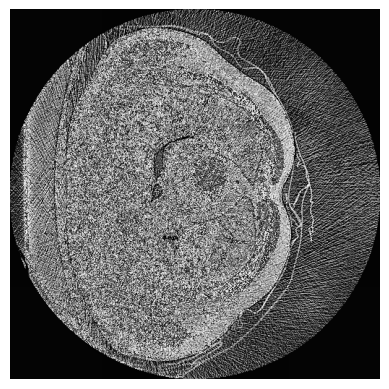

Patient 8 has 251 slices


 18%|█▊        | 9/51 [00:06<00:27,  1.51it/s]

513 549
CLAHE normalization


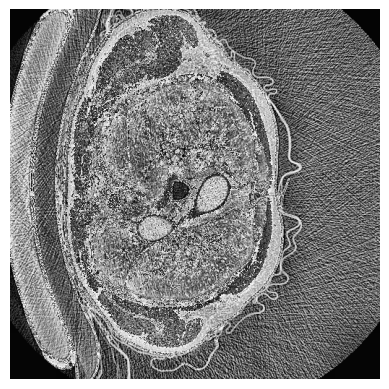

Patient 9 has 636 slices


 20%|█▉        | 10/51 [00:08<00:33,  1.23it/s]

197 272
CLAHE normalization


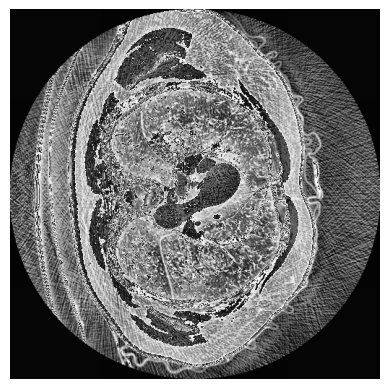

 22%|██▏       | 11/51 [00:09<00:34,  1.16it/s]

Patient 10 has 301 slices
223 258
CLAHE normalization


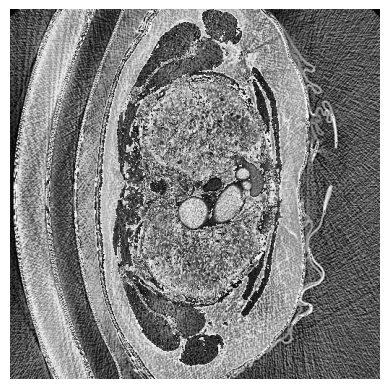

Patient 11 has 304 slices


 24%|██▎       | 12/51 [00:09<00:32,  1.22it/s]

59 83
CLAHE normalization


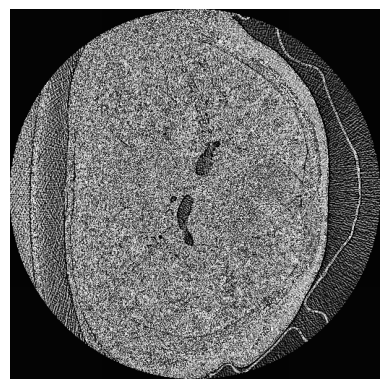

 25%|██▌       | 13/51 [00:10<00:29,  1.27it/s]

Patient 12 has 115 slices
59 99
CLAHE normalization


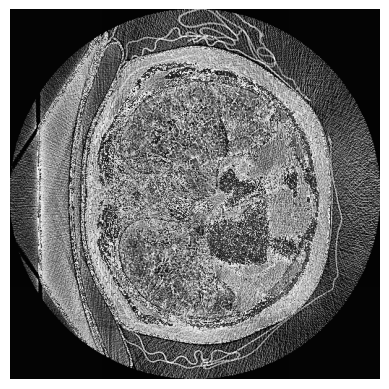

Patient 13 has 241 slices


 27%|██▋       | 14/51 [00:11<00:27,  1.33it/s]

178 207
CLAHE normalization


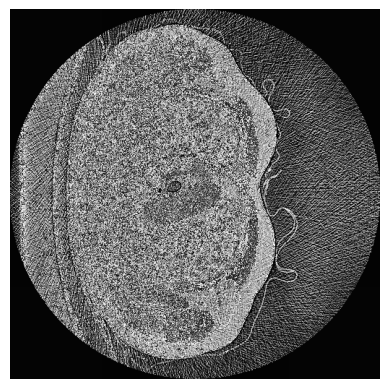

Patient 14 has 249 slices


 29%|██▉       | 15/51 [00:11<00:25,  1.42it/s]

141 172
CLAHE normalization


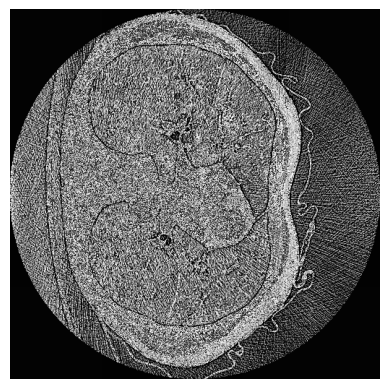

Patient 15 has 289 slices


 31%|███▏      | 16/51 [00:12<00:24,  1.43it/s]

127 177
CLAHE normalization


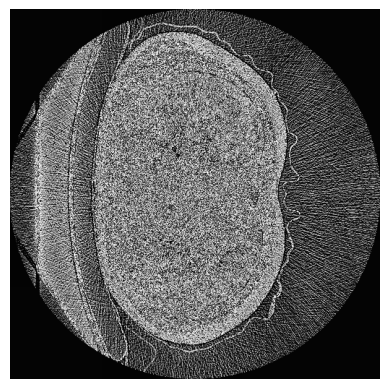

Patient 16 has 282 slices


 33%|███▎      | 17/51 [00:13<00:24,  1.38it/s]

192 221
CLAHE normalization


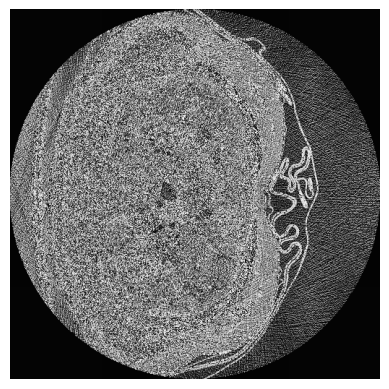

Patient 17 has 291 slices


 35%|███▌      | 18/51 [00:14<00:24,  1.37it/s]

209 239
CLAHE normalization


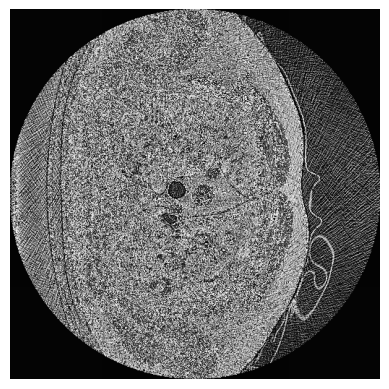

Patient 18 has 276 slices


 37%|███▋      | 19/51 [00:14<00:22,  1.41it/s]

152 194
CLAHE normalization


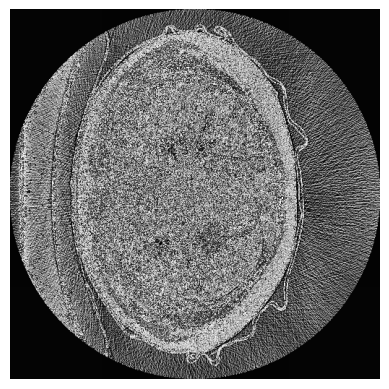

 39%|███▉      | 20/51 [00:15<00:22,  1.41it/s]

Patient 19 has 296 slices
439 494
CLAHE normalization


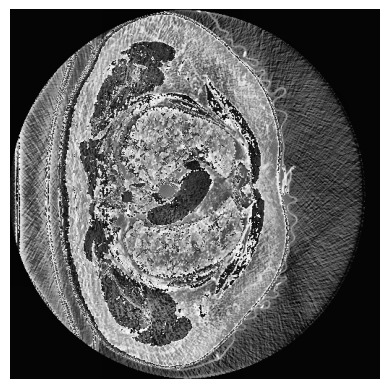

Patient 20 has 567 slices


 41%|████      | 21/51 [00:16<00:25,  1.16it/s]

291 341
CLAHE normalization


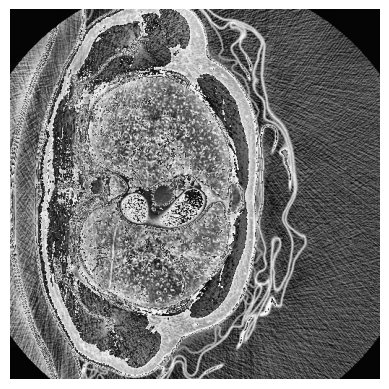

Patient 21 has 423 slices


 43%|████▎     | 22/51 [00:17<00:26,  1.11it/s]

136 180
CLAHE normalization


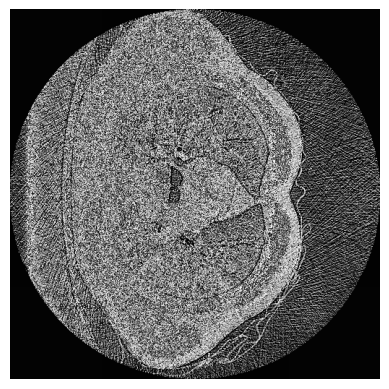

Patient 22 has 242 slices


 45%|████▌     | 23/51 [00:18<00:23,  1.18it/s]

137 169
CLAHE normalization


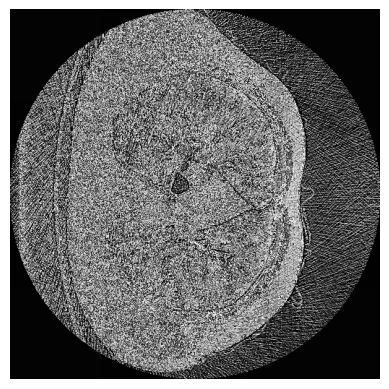

 47%|████▋     | 24/51 [00:18<00:21,  1.27it/s]

Patient 23 has 243 slices
84 112
CLAHE normalization


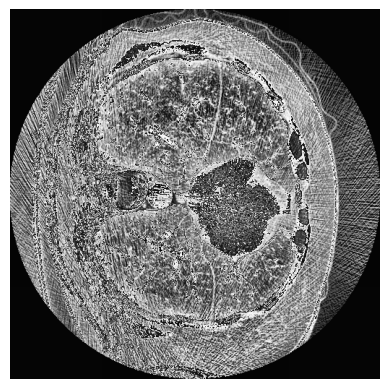

 49%|████▉     | 25/51 [00:19<00:19,  1.35it/s]

Patient 24 has 251 slices
82 109
CLAHE normalization


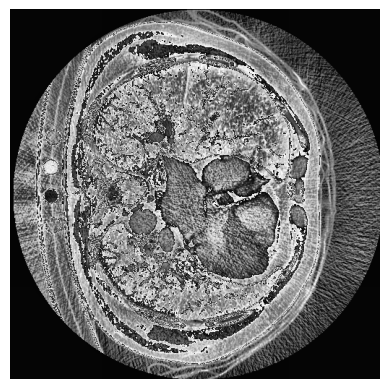

 51%|█████     | 26/51 [00:20<00:16,  1.50it/s]

Patient 25 has 155 slices
79 126
CLAHE normalization


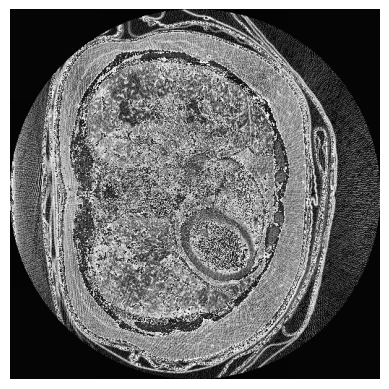

Patient 26 has 241 slices


 53%|█████▎    | 27/51 [00:20<00:16,  1.43it/s]

208 293
CLAHE normalization


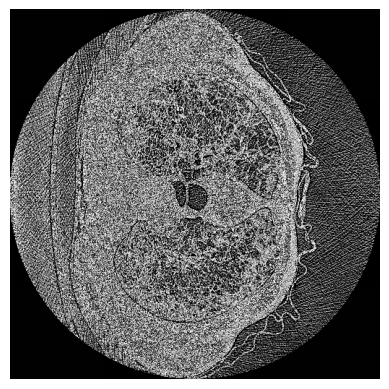

Patient 27 has 304 slices


 55%|█████▍    | 28/51 [00:21<00:18,  1.24it/s]

137 173
CLAHE normalization


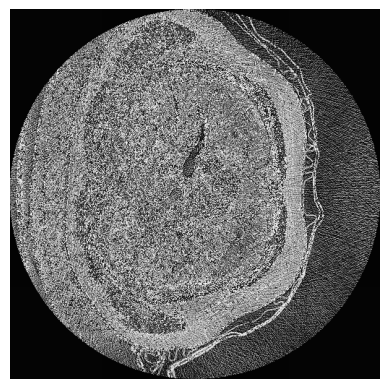

Patient 28 has 228 slices


 57%|█████▋    | 29/51 [00:22<00:16,  1.31it/s]

120 149
CLAHE normalization


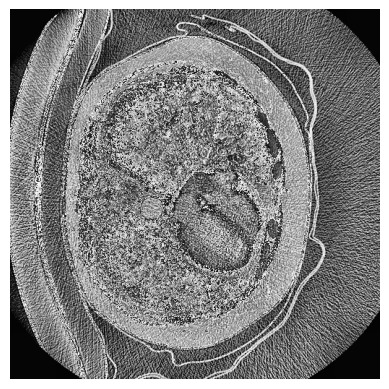

Patient 29 has 322 slices


 59%|█████▉    | 30/51 [00:23<00:15,  1.34it/s]

130 173
CLAHE normalization


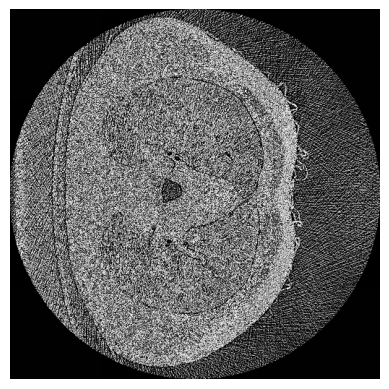

Patient 30 has 226 slices


 61%|██████    | 31/51 [00:23<00:14,  1.37it/s]

97 123
CLAHE normalization


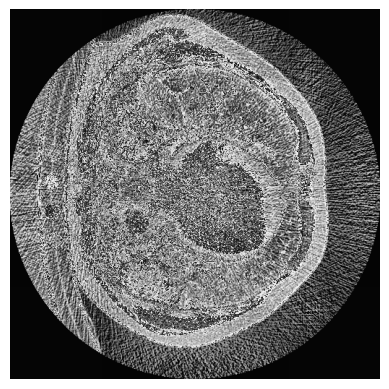

Patient 31 has 256 slices


 63%|██████▎   | 32/51 [00:24<00:13,  1.41it/s]

356 415
CLAHE normalization


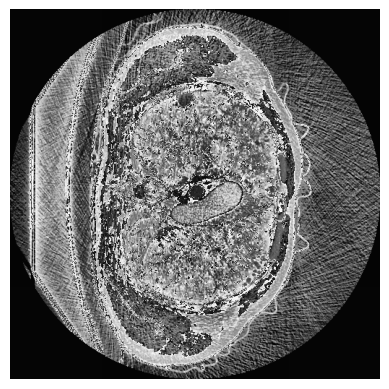

Patient 32 has 531 slices


 65%|██████▍   | 33/51 [00:25<00:15,  1.19it/s]

203 287
CLAHE normalization


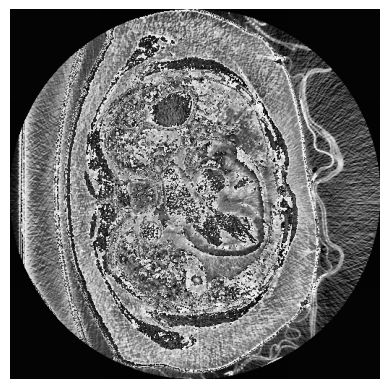

Patient 33 has 483 slices


 67%|██████▋   | 34/51 [00:27<00:16,  1.01it/s]

200 228
CLAHE normalization


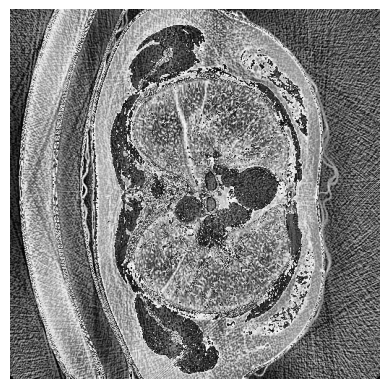

Patient 34 has 314 slices


 69%|██████▊   | 35/51 [00:27<00:14,  1.09it/s]

148 184
CLAHE normalization


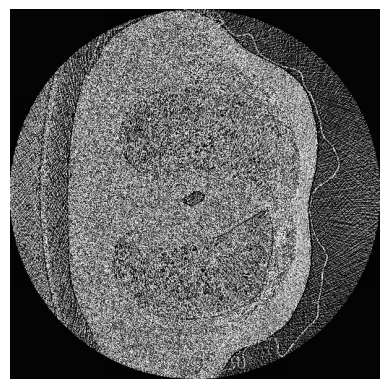

Patient 35 has 241 slices


 71%|███████   | 36/51 [00:28<00:12,  1.19it/s]

79 105
CLAHE normalization


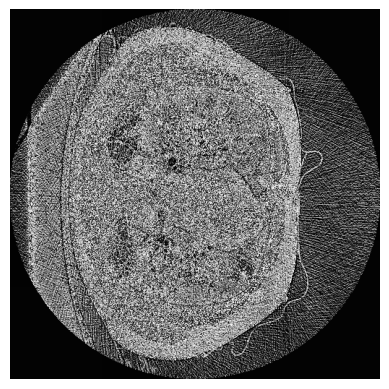

Patient 36 has 211 slices


 73%|███████▎  | 37/51 [00:29<00:10,  1.33it/s]

66 100
CLAHE normalization


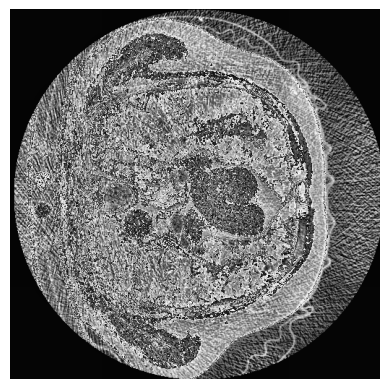

 75%|███████▍  | 38/51 [00:29<00:08,  1.47it/s]

Patient 37 has 128 slices
117 143
CLAHE normalization


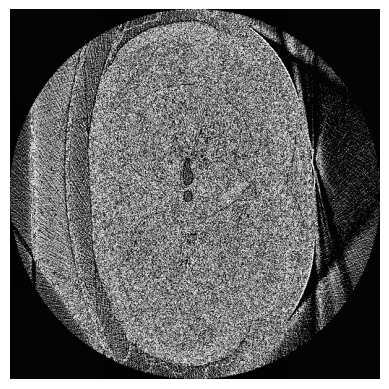

Patient 38 has 218 slices


 76%|███████▋  | 39/51 [00:30<00:07,  1.53it/s]

111 181
CLAHE normalization


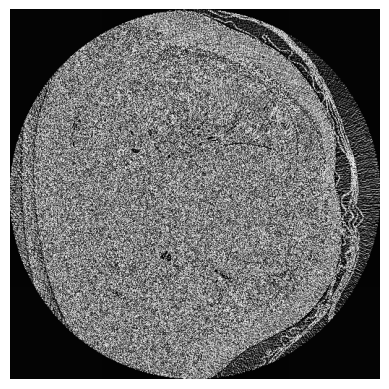

Patient 39 has 248 slices


 78%|███████▊  | 40/51 [00:30<00:07,  1.42it/s]

140 165
CLAHE normalization


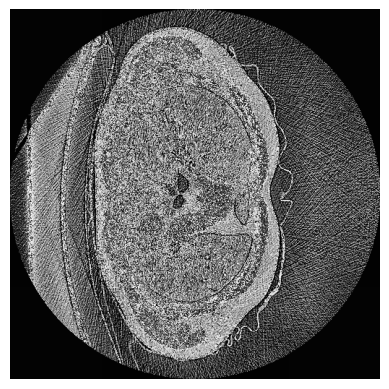

 80%|████████  | 41/51 [00:31<00:06,  1.51it/s]

Patient 40 has 241 slices
80 109
CLAHE normalization


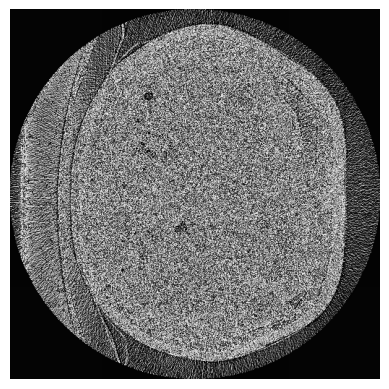

Patient 41 has 271 slices


 82%|████████▏ | 42/51 [00:32<00:05,  1.50it/s]

79 172
CLAHE normalization


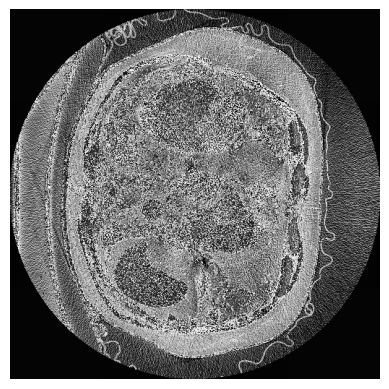

Patient 42 has 251 slices


 84%|████████▍ | 43/51 [00:33<00:06,  1.30it/s]

153 204
CLAHE normalization


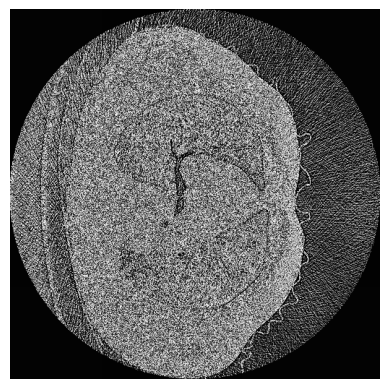

Patient 43 has 241 slices


 86%|████████▋ | 44/51 [00:34<00:05,  1.31it/s]

147 188
CLAHE normalization


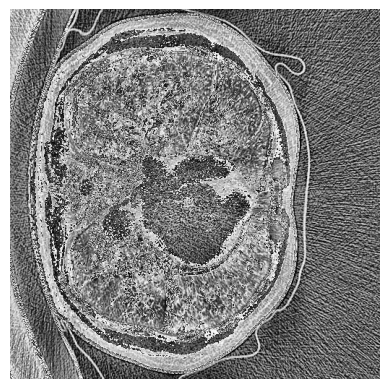

Patient 44 has 329 slices


 88%|████████▊ | 45/51 [00:34<00:04,  1.30it/s]

113 142
CLAHE normalization


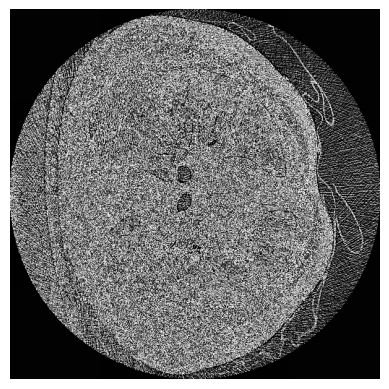

 90%|█████████ | 46/51 [00:35<00:03,  1.41it/s]

Patient 45 has 228 slices
83 113
CLAHE normalization


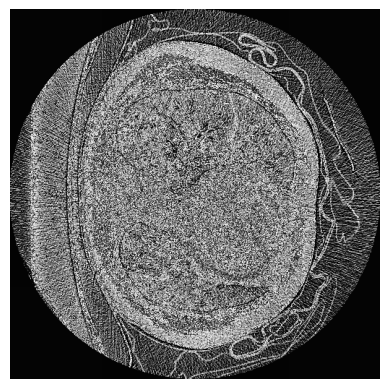

Patient 46 has 242 slices


 92%|█████████▏| 47/51 [00:36<00:02,  1.40it/s]

140 234
CLAHE normalization


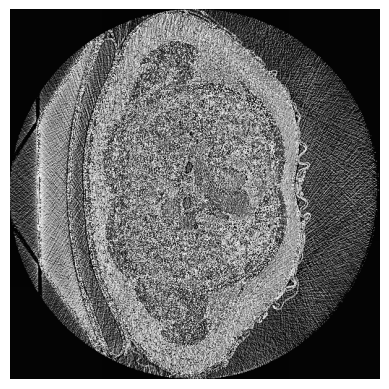

Patient 47 has 252 slices


 94%|█████████▍| 48/51 [00:37<00:02,  1.20it/s]

141 170
CLAHE normalization


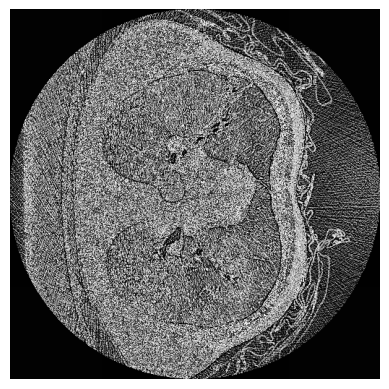

Patient 48 has 266 slices


 96%|█████████▌| 49/51 [00:37<00:01,  1.29it/s]

99 120
CLAHE normalization


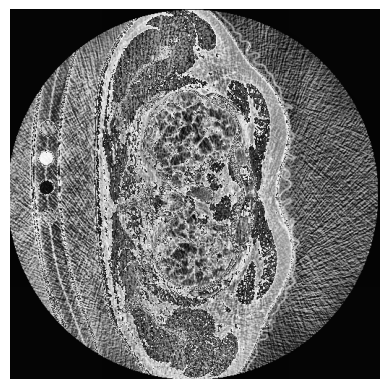

 98%|█████████▊| 50/51 [00:38<00:00,  1.48it/s]

Patient 49 has 126 slices
68 92
CLAHE normalization


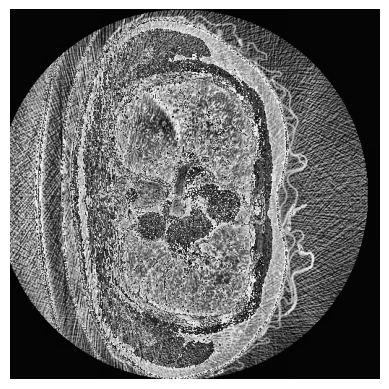

100%|██████████| 51/51 [00:38<00:00,  1.32it/s]

Patient 50 has 125 slices
Saved 50 images and masks for training split


In [42]:
save_dataset(train_dataset, 'MedicalDecathlonClaheLungs', train_name, take_slices_flag = True, slices = patient_tumorous_slices, normalize_flag = True, normalization_method = 'clahe', remove_bed_flag = True, lungs_bbox = bbox_2d)

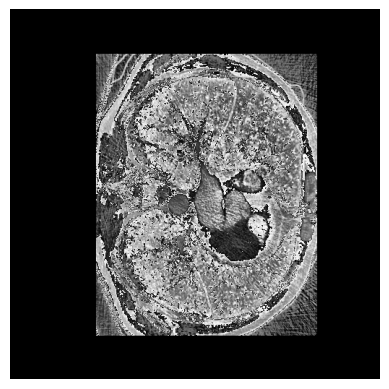

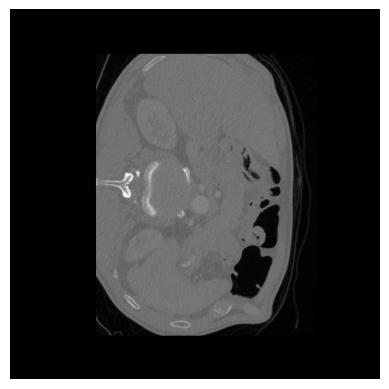

In [12]:
a = '/home/aimas/Desktop/Disertatie_CataChiru/LungCancerCT/datasets/MedicalDecathlonClaheLungs/training/images/patient_32.pt'
# b = '/home/aimas/Desktop/Disertatie_CataChiru/LungCancerCT/datasets/MedicalDecathlonAugmentedLungs/training/images/patient_32.pt'

b = '/home/aimas/Desktop/Disertatie_CataChiru/LungCancerCT/datasets/MedicalDecathlonAugmentedLungs/training/images/patient_0.pt'

a = torch.load(a)
b = torch.load(b)

plt.imshow(a[0, ..., 150], cmap='gray')
plt.gca().invert_yaxis()
plt.axis('off')
plt.show()

plt.imshow(b[0, ..., 0], cmap='gray')
plt.gca().invert_yaxis()
plt.axis('off')
plt.show()

# Equivalent to original dataset patient 32, slice 238

In [10]:
### VALIDATION DATA ###
val_name = 'validation' # From Monai: ['training', 'validation', 'test']
val_dataset = DecathlonDataset(root_dir = datasets_path,
                        task = "Task06_Lung", section = val_name,
                        transform = base_transform, download = DOWNLOAD_FLAG)

Loading dataset: 100%|██████████| 12/12 [00:57<00:00,  4.81s/it]


  0%|          | 0/12 [00:00<?, ?it/s]

259 322


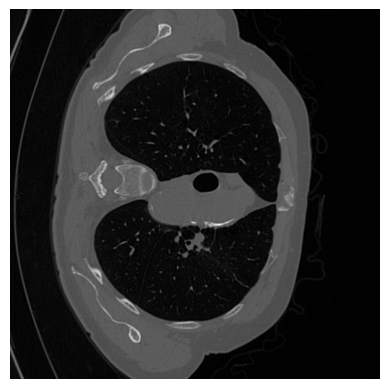

Patient 0 has 369 slices


  8%|▊         | 1/12 [00:00<00:09,  1.17it/s]

180 243


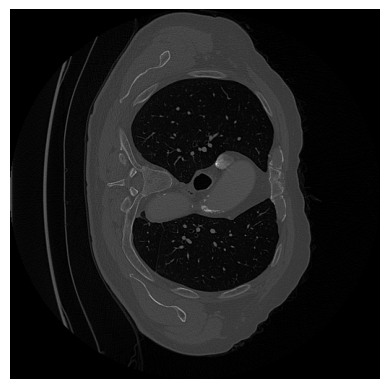

Patient 1 has 255 slices


 17%|█▋        | 2/12 [00:01<00:07,  1.37it/s]

110 173


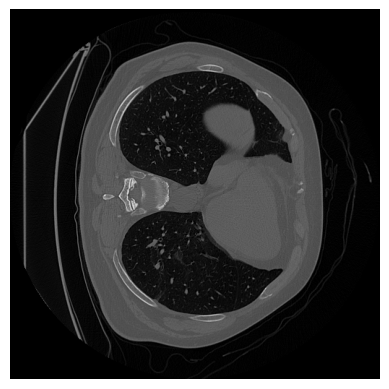

Patient 2 has 288 slices


 25%|██▌       | 3/12 [00:02<00:06,  1.34it/s]

196 259


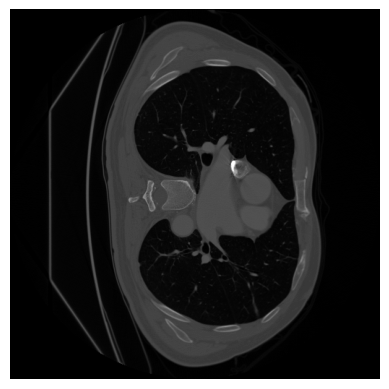

Patient 3 has 376 slices


 33%|███▎      | 4/12 [00:03<00:06,  1.28it/s]

17 80


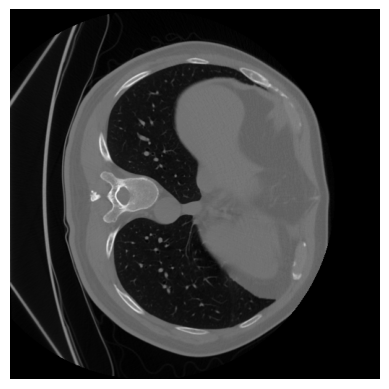

 42%|████▏     | 5/12 [00:03<00:04,  1.50it/s]

Patient 4 has 112 slices
81 144


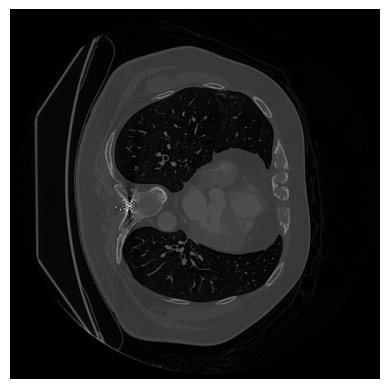

Patient 5 has 245 slices


 50%|█████     | 6/12 [00:04<00:03,  1.54it/s]

80 143


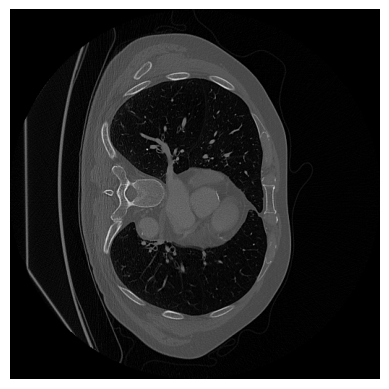

Patient 6 has 252 slices


 58%|█████▊    | 7/12 [00:04<00:03,  1.51it/s]

73 136


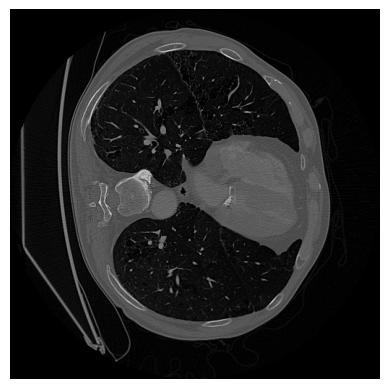

Patient 7 has 231 slices


 67%|██████▋   | 8/12 [00:05<00:02,  1.56it/s]

65 128


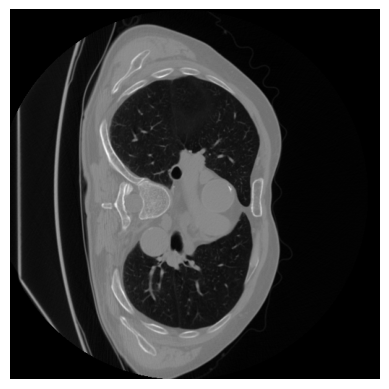

 75%|███████▌  | 9/12 [00:06<00:01,  1.62it/s]

Patient 8 has 129 slices
131 194


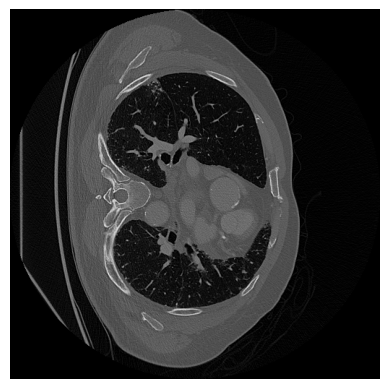

 83%|████████▎ | 10/12 [00:06<00:01,  1.61it/s]

Patient 9 has 240 slices
300 363


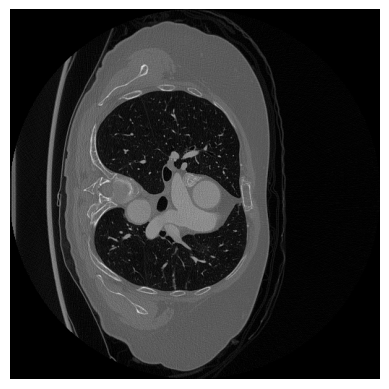

Patient 10 has 493 slices


 92%|█████████▏| 11/12 [00:07<00:00,  1.41it/s]

58 121


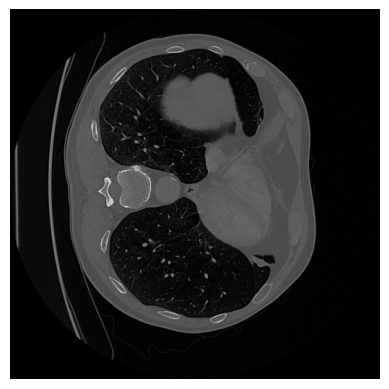

100%|██████████| 12/12 [00:08<00:00,  1.46it/s]

Patient 11 has 264 slices
Saved 11 images and masks for validation split


In [28]:
save_dataset(val_dataset, 'MedicalDecathlonJustTumors', val_name, take_slices_flag = True, slices = patient_useful_slices_val, normalize_flag = True, normalization_method = 'min-max', remove_bed_flag = True, lungs_bbox = bbox_2d)

In [36]:
save_dataset(val_dataset, 'MedicalDecathlonAugmentedTumors2', val_name, normalize_flag = True, normalization_method = 'min-max', remove_bed_flag = True, lungs_bbox = bbox_2d)

  0%|          | 0/12 [00:00<?, ?it/s]

Patient 0 has 369 slices


  8%|▊         | 1/12 [00:01<00:16,  1.54s/it]

Patient 1 has 255 slices


 17%|█▋        | 2/12 [00:02<00:12,  1.22s/it]

Patient 2 has 288 slices


 25%|██▌       | 3/12 [00:03<00:11,  1.22s/it]

Patient 3 has 376 slices


 42%|████▏     | 5/12 [00:05<00:07,  1.03s/it]

Patient 4 has 112 slices
Patient 5 has 245 slices


 50%|█████     | 6/12 [00:06<00:06,  1.01s/it]

Patient 6 has 252 slices


 67%|██████▋   | 8/12 [00:09<00:04,  1.11s/it]

Patient 7 has 231 slices


 75%|███████▌  | 9/12 [00:09<00:02,  1.04it/s]

Patient 8 has 129 slices


 83%|████████▎ | 10/12 [00:11<00:02,  1.15s/it]

Patient 9 has 240 slices
Patient 10 has 493 slices


 92%|█████████▏| 11/12 [00:24<00:04,  4.75s/it]

Patient 11 has 264 slices


100%|██████████| 12/12 [00:31<00:00,  2.58s/it]

Saved 11 images and masks for validation split


  0%|          | 0/12 [00:00<?, ?it/s]

CLAHE normalization


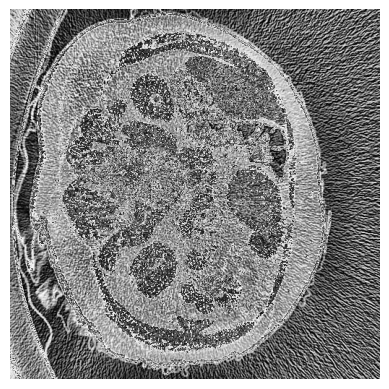

Patient 0 has 369 slices


  8%|▊         | 1/12 [00:02<00:30,  2.81s/it]

CLAHE normalization


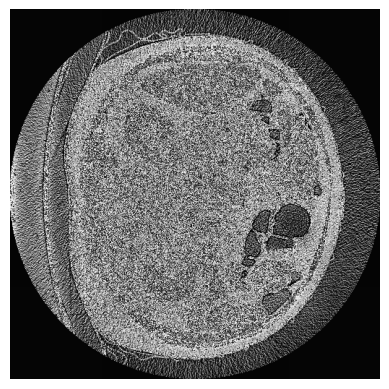

Patient 1 has 255 slices


 17%|█▋        | 2/12 [00:04<00:23,  2.32s/it]

CLAHE normalization


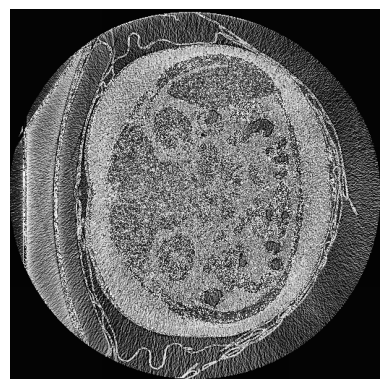

 25%|██▌       | 3/12 [00:06<00:20,  2.24s/it]

Patient 2 has 288 slices
CLAHE normalization


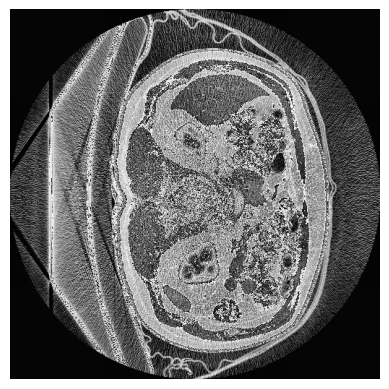

 33%|███▎      | 4/12 [00:09<00:19,  2.42s/it]

Patient 3 has 376 slices
CLAHE normalization


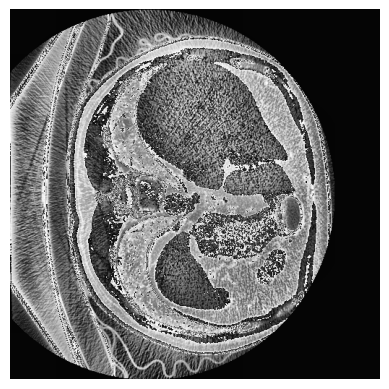

 42%|████▏     | 5/12 [00:10<00:12,  1.85s/it]

Patient 4 has 112 slices
CLAHE normalization


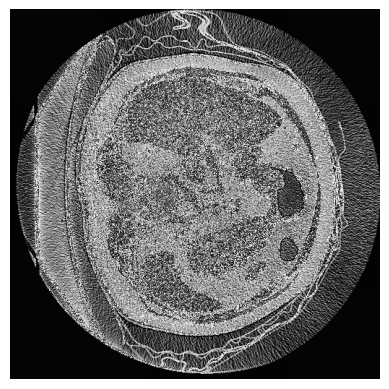

Patient 5 has 245 slices


 50%|█████     | 6/12 [00:12<00:11,  1.89s/it]

CLAHE normalization


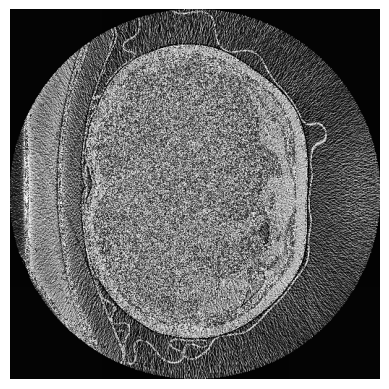

 58%|█████▊    | 7/12 [00:14<00:09,  1.87s/it]

Patient 6 has 252 slices
CLAHE normalization


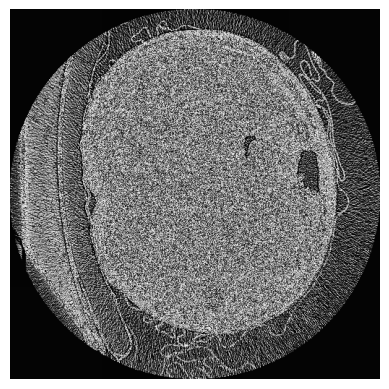

Patient 7 has 231 slices


 67%|██████▋   | 8/12 [00:15<00:07,  1.81s/it]

CLAHE normalization


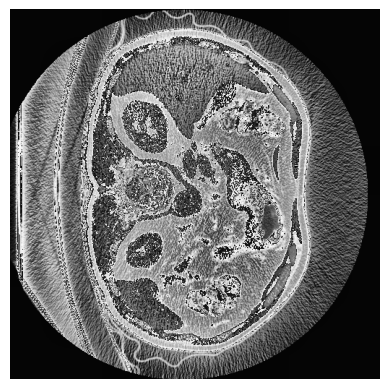

 75%|███████▌  | 9/12 [00:16<00:04,  1.56s/it]

Patient 8 has 129 slices
CLAHE normalization


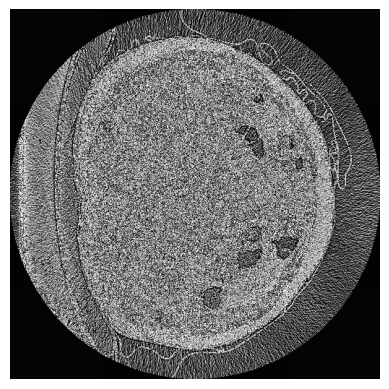

Patient 9 has 240 slices


 83%|████████▎ | 10/12 [00:18<00:03,  1.58s/it]

CLAHE normalization


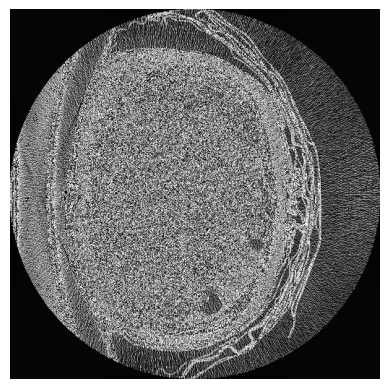

 92%|█████████▏| 11/12 [00:22<00:02,  2.23s/it]

Patient 10 has 493 slices
CLAHE normalization


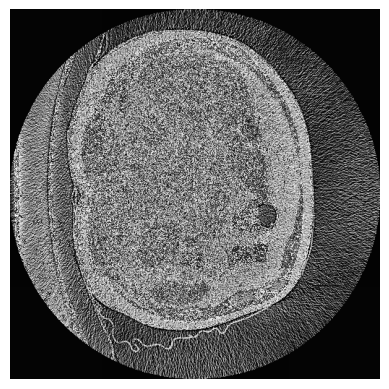

100%|██████████| 12/12 [00:24<00:00,  2.03s/it]

Patient 11 has 264 slices
Saved 11 images and masks for validation split


In [44]:
save_dataset(val_dataset, 'MedicalDecathlonClaheTumors', val_name, normalize_flag = True, normalization_method = 'clahe', remove_bed_flag = True, lungs_bbox = bbox_2d)